# Style Transfer

<img src="https://i0.wp.com/chelseatroy.com/wp-content/uploads/2018/12/neural_style_transfer.png?resize=768%2C311&ssl=1">

La idea de este trabajo final es reproducir el siguiente paper:

https://arxiv.org/pdf/1508.06576.pdf

El objetivo es transferir el estilo de una imagen dada a otra imagen distinta. 

Como hemos visto en clase, las primeras capas de una red convolucional se activan ante la presencia de ciertos patrones vinculados a detalles muy pequeños.

A medida que avanzamos en las distintas capas de una red neuronal convolucional, los filtros se van activando a medida que detectan patrones de formas cada vez mas complejos.

Lo que propone este paper es asignarle a la activación de las primeras capas de una red neuronal convolucional (por ejemplo VGG19) la definición del estilo y a la activación de las últimas capas de la red neuronal convolucional, la definición del contenido.

La idea de este paper es, a partir de dos imágenes (una que aporte el estilo y otra que aporte el contenido) analizar cómo es la activación de las primeras capas para la imagen que aporta el estilo y cómo es la activación de las últimas capas de la red convolucional para la imagen que aporta el contenido. A partir de esto se intentará sintetizar una imagen que active los filtros de las primeras capas que se activaron con la imagen que aporta el estilo y los filtros de las últimas capas que se activaron con la imagen que aporta el contenido.

A este procedimiento se lo denomina neural style transfer.

# En este trabajo se deberá leer el paper mencionado y en base a ello, entender la implementación que se muestra a continuación y contestar preguntas sobre la misma.

# Una metodología posible es hacer una lectura rápida del paper (aunque esto signifique no entender algunos detalles del mismo) y luego ir analizando el código y respondiendo las preguntas. A medida que se planteen las preguntas, volviendo a leer secciones específicas del paper terminará de entender los detalles que pudieran haber quedado pendientes.

Lo primero que haremos es cargar dos imágenes, una que aporte el estilo y otra que aporte el contenido. A tal fin utilizaremos imágenes disponibles en la web.

In [ ]:
# Imagen para estilo
!wget https://upload.wikimedia.org/wikipedia/commons/5/52/La_noche_estrellada1.jpg

# Imagen para contenido
!wget https://upload.wikimedia.org/wikipedia/commons/thumb/f/f4/Neckarfront_T%C3%BCbingen_Mai_2017.jpg/775px-Neckarfront_T%C3%BCbingen_Mai_2017.jpg

# Creamos el directorio para los archivos de salida
!mkdir /content/output

In [1]:
from tensorflow.keras.utils import load_img, save_img, img_to_array
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
import time
import os
import argparse

import matplotlib.pylab as plt
import matplotlib.image as mpimg

from keras.applications import vgg19
from keras import backend as K
from pathlib import Path

os.environ['KMP_DUPLICATE_LIB_OK']='True'

from tensorflow.compat.v1 import disable_eager_execution
disable_eager_execution() #llamar antes de crear cualquier tensor

In [2]:
# Definimos las imagenes que vamos a utilizar, y el directorio de salida

base_image_path = Path("content/775px-Neckarfront_Tübingen_Mai_2017.jpg")
style_reference_image_path = Path("content/La_noche_estrellada1.jpg")
result_prefix = Path("content/output")
iterations = 20

# 1) En base a lo visto en el paper ¿Qué significan los parámetros definidos en la siguiente celda?

Respuesta:

Todos ellos son hipermarámetros del modelo.

style_weight y content_weight definen el peso relativo que se le va a dar en el modelo a la imagen que aportará el estilo y a la imagen que aportará el contenido, aplicándolos respectivamente en cada término de la loss. En el paper style_weight se define como Beta y content_weight como Alpha.

total_variation_weight es un factor aplicado sobre un término de regularización en la loss total con el objetivo de eliminar ruido en la imagen (método conocido como Total Variation Denoising)


In [3]:
total_variation_weight = 0.1
style_weight = 10
content_weight = 1

In [4]:
# Definimos el tamaño de las imágenes a utilizar
width, height = load_img(base_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows / height)
print((img_nrows, img_ncols))

(400, 517)


# 2) Explicar qué hace la siguiente celda. En especial las últimas dos líneas de la función antes del return. ¿Por qué?

Ayuda: https://keras.io/applications/

Respuesta:

load_img: Carga la imagen especificada, por defecto en formato RGB, y le aplica un escalado en base al alto y ancho especificado en el parámetro target_size. Devuelve un objeto PIL (Python Imaging Library)

img_to_array: Convierte la imagen almacenada en el objeto de la clase PIL a un Numpy array, de dimensiones (height, width, channels)

expand_dims: Agrega una nueva dimensión al arreglo que representaría la cantidad de imagenes a procesar

vgg19.preprocess_input: Convierte el arreglo del formato RGB al formato BGR que espera el modelo VGG19 y además centra cada color en cero restandole la media de todas las imagenes del dataset ImageNet con el que fue entrenado el modelo. Devuelve un Numpy array con las mismas dimensiones que el de entrada.

In [5]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

# 3) Habiendo comprendido lo que hace la celda anterior, explique de manera muy concisa qué hace la siguiente celda. ¿Qué relación tiene con la celda anterior?

Respuesta:

La siguiente función deshace el proceso anterior, es decir, elimina la dimensión extra agregada, convierte de BGR a RGB y descentra cada color desde cero. El objetivo es poder volver a visualizar la imagen generada con el modelo.

In [6]:
def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [7]:
# get tensor representations of our images
# K.variable convierte un numpy array en un tensor, para 
base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

In [8]:
combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

Aclaración:

La siguiente celda sirve para procesar las tres imagenes (contenido, estilo y salida) en un solo batch.

In [9]:
# combine the 3 images into a single Keras tensor
input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)
input_tensor.shape

TensorShape([3, 400, 517, 3])

In [10]:
# build the VGG19 network with our 3 images as input
# the model will be loaded with pre-trained ImageNet weights
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

# get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

Model loaded.


In [11]:
outputs_dict['block5_conv2'][0, :, :, :]

<tf.Tensor 'strided_slice:0' shape=(25, 32, 512) dtype=float32>

# 4) En la siguientes celdas:

- ¿Qué es la matriz de Gram?¿Para qué se usa?

La matriz de Gram se obtiene como el producto punto de los mapas de características vectorizados con su transpuesta. Este producto punto nos da informacion de que tan correlacionados están ambos terminos, y en otras palabras, un valor bajo indicaría que ambas caracteristicas co-existen poco, mientras un valor alto indicaría que co-existen mucho. Esto último, al ser aplicado sobre los mapas de características de distintas capas de la red, se puede pensar como un indicador de la textura o el sestilo de la imagen que es lo que justamente se pretende extraer aplicando esta matriz a los mapas de características de la imagen de entrada y de la imagen de salida dentro del cálculo de la loss. El proceso de vectorizacion ademas destruye la informacion espacial para ignorar la parte del contenido y solo resaltar el estilo.

- ¿Por qué se permutan las dimensiones de x?

Las dimensiones de x se deben permutar para poder hacer la vectorización de los mapas de características en el orden adecuado.

In [12]:
out_tmp = outputs_dict['block5_conv2'][0, :, :, :]
print(out_tmp.shape)
print(K.permute_dimensions(out_tmp, (2, 0, 1)).shape)
print(K.batch_flatten(K.permute_dimensions(out_tmp, (2, 0, 1))).shape)

(25, 32, 512)
(512, 25, 32)
(512, 800)


Se puede ver que si la salida de una cierta capa es de dimensión (25, 32, 512) (alto, ancho, cantidad de filtros en la capa), la permutación la transforma a una dimensión (512, 25, 32) y luego con el flatten se pasa a la dimensión (512,800), o sea se vectoriza el ancho y el alto

In [13]:
def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

# 5) Losses:

Explicar qué mide cada una de las losses en las siguientes tres celdas.

Rta:

La style_loss mide la diferencia de estilo entre la imagen generada y la original (usada para dar estilo). Lo hace computando el error cuadrático medio entre las matrices de Gram de los mapas de características a la salida de una cierta capa que corresponden a la imagen original de estilo y la imagen generada.

La content_loss mide la diferencia de contenido entre la imagen generada y la original (usada para dar contenido). Lo hace computandoel error cuadrático medio directamente entre los mapas de características a la salida de una cierta capa que corresponden a la imagen original de contenido y la imagen generada.

La total_variation_loss conforma un termino de regularización para el suavizado de ruido de alta frecuencia. Lo hace computando la suma de las diferencias absolutas entre valores de píxeles contiguos, buscando finalmente minimizar los saltos abruptos entre pixeles oscuros y claros.

In [14]:
def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

In [15]:
def content_loss(base, combination):
    return K.sum(K.square(combination - base))


In [16]:
def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))


In [17]:
# Armamos la loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :] 
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [18]:
grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

# 6) Explique el propósito de las siguientes tres celdas. ¿Qué hace la función fmin_l_bfgs_b? ¿En qué se diferencia con la implementación del paper? ¿Se puede utilizar alguna alternativa?

Respuesta:

En las siguientes celdas se ejecuta iterativamente el optimizador para obtener una imagen de salida cada vez más cercana a la combinación deseada. La loss y los gradientes se obtienen en dos funciones separadas como lo espera la función fmin_l_bfgs_b pero se computan de una sola vez para no generar ineficiencias de cálculo.

fmin_l_bfgs_b minimiza la loss empleando el algoritmo de optimización L-BFGS-B, que es una aproximación del algoritmo Broyden-Fletcher-Goldfarb-Shanno, y cuya ventja es la eficiencia ya que utiliza una cantidad limitada de memoria. 

En el paper se utiliza el descenso del gradiente como método de optimización. Se pueden utilizar otras alternativas como Adam, Adagrad o RMSprop.

In [19]:
def eval_loss_and_grads(x):
    x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

# this Evaluator class makes it possible
# to compute loss and gradients in one pass
# while retrieving them via two separate functions,
# "loss" and "grads". This is done because scipy.optimize
# requires separate functions for loss and gradients,
# but computing them separately would be inefficient.

In [20]:
class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

# 7) Ejecute la siguiente celda y observe las imágenes de salida en cada iteración.fname = result_prefix + ('/output_at_iteration_%d.png' % i)

In [21]:
evaluator = Evaluator()

# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x = preprocess_image(base_image_path)

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))
if not os.path.exists(out_folder):
    os.makedirs(out_folder)

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(), fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = os.path.join(out_folder, ('output_at_iteration_%d.png' % i))
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 13324761000.0
Image saved as content\output\output_stylew_10_contw_1_totvarw_0p1\output_at_iteration_0.png
Iteration 0 completed in 125s
Start of iteration 1
Current loss value: 6496566300.0
Image saved as content\output\output_stylew_10_contw_1_totvarw_0p1\output_at_iteration_1.png
Iteration 1 completed in 121s
Start of iteration 2
Current loss value: 4436013600.0
Image saved as content\output\output_stylew_10_contw_1_totvarw_0p1\output_at_iteration_2.png
Iteration 2 completed in 122s
Start of iteration 3
Current loss value: 3449623600.0
Image saved as content\output\output_stylew_10_contw_1_totvarw_0p1\output_at_iteration_3.png
Iteration 3 completed in 125s
Start of iteration 4
Current loss value: 2772767500.0
Image saved as content\output\output_stylew_10_contw_1_totvarw_0p1\output_at_iteration_4.png
Iteration 4 completed in 123s
Start of iteration 5
Current loss value: 2370366000.0
Image saved as content\output\output_stylew_10_contw_1_totva

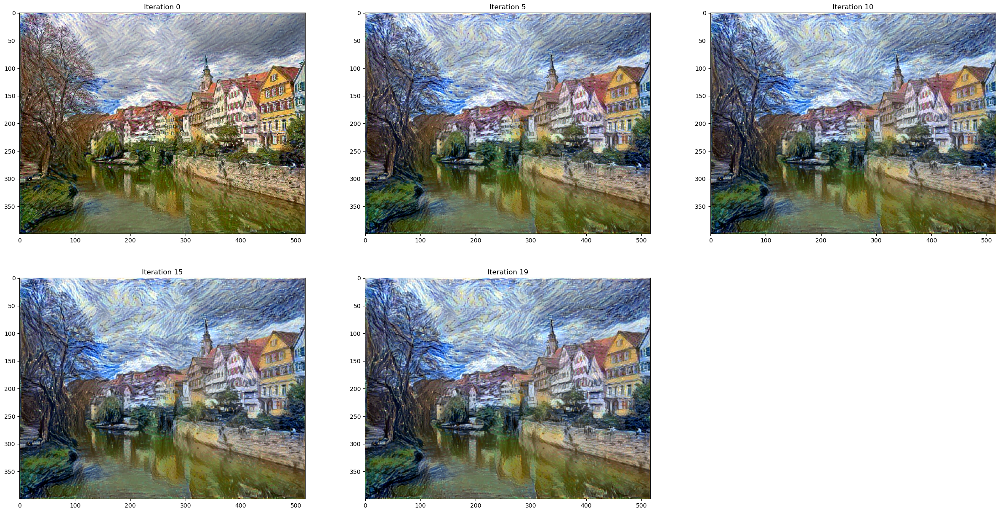

In [22]:
# total_variation_weight = 0.1
# style_weight = 10
# content_weight = 1

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

images = []
iterations_to_show = [0,5,10,15,19]
for n_iter in iterations_to_show:
    images.append(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % n_iter))))

plt.figure(figsize=(30,15))
columns = 3
for i, image in enumerate(images):
    plt.subplot(len(images) // columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.title("Iteration %d"%iterations_to_show[i])

# 8) Generar imágenes para distintas combinaciones de pesos de las losses. Explicar las diferencias. (Adjuntar las imágenes generadas como archivos separados.)

Respuesta:


En los siguientes casos, se modifica la relación entre el style_weight y content_weight, genereando relaciones de 100 a 1 entre style_weight y content_weight, luego a la inversa y finalmente definiendo a ambos pesos por igual. 
Se puede ver en las imagenes resultantes que el aumento del style_weight respecto del content_weight comienza a producir una deformacion notoria sobre las estructuras de contenido de la imagen (techos de las casas, arboles, reflejos en el agua) debido a que se le da más fuerza a los efectos de la imagen de estilo.
Por otro lado, el aumento del content_weight respecto del style_weight, hace que las estructuras de la imagen de contenido queden muy bien definidas, dejando ver muy poco el efecto de estilo obtenido del cuadro de la noche estrellada.

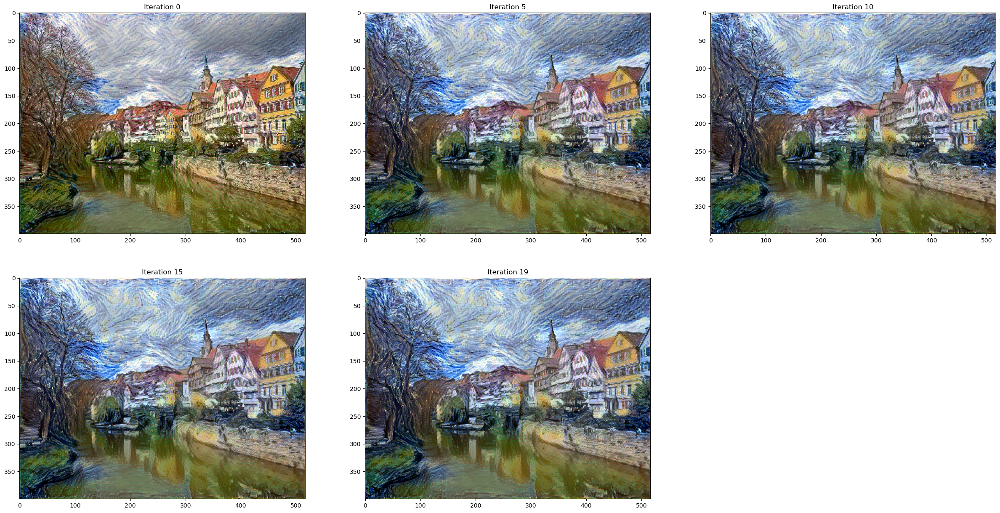

In [97]:
total_variation_weight = 0.1
style_weight = 100
content_weight = 1

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

images = []
iterations_to_show = [0,5,10,15,19]
for n_iter in iterations_to_show:
    images.append(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % n_iter))))

plt.figure(figsize=(30,15))
columns = 3
for i, image in enumerate(images):
    plt.subplot(len(images) // columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.title("Iteration %d"%iterations_to_show[i])

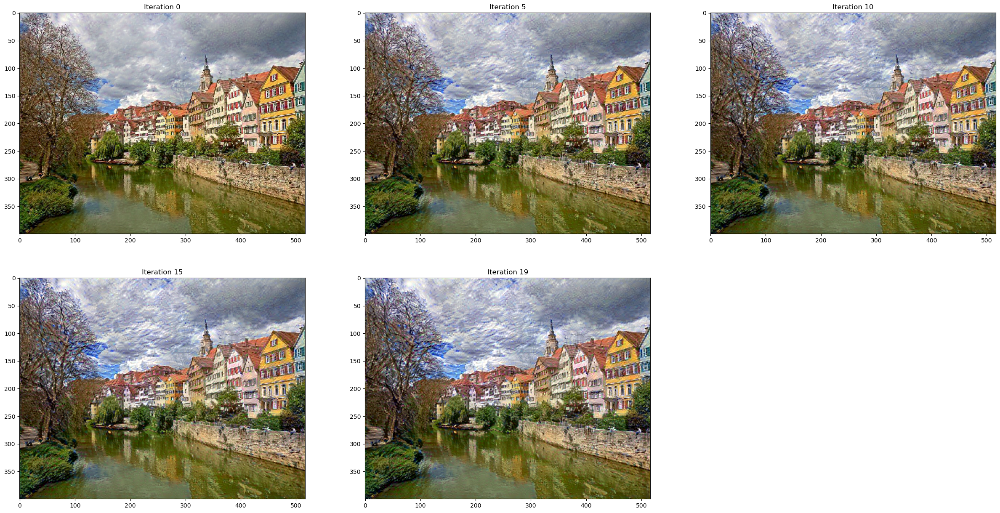

In [96]:
total_variation_weight = 0.1
style_weight = 1
content_weight = 100

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

images = []
iterations_to_show = [0,5,10,15,19]
for n_iter in iterations_to_show:
    images.append(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % n_iter))))

plt.figure(figsize=(30,15))
columns = 3
for i, image in enumerate(images):
    plt.subplot(len(images) // columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.title("Iteration %d"%iterations_to_show[i])

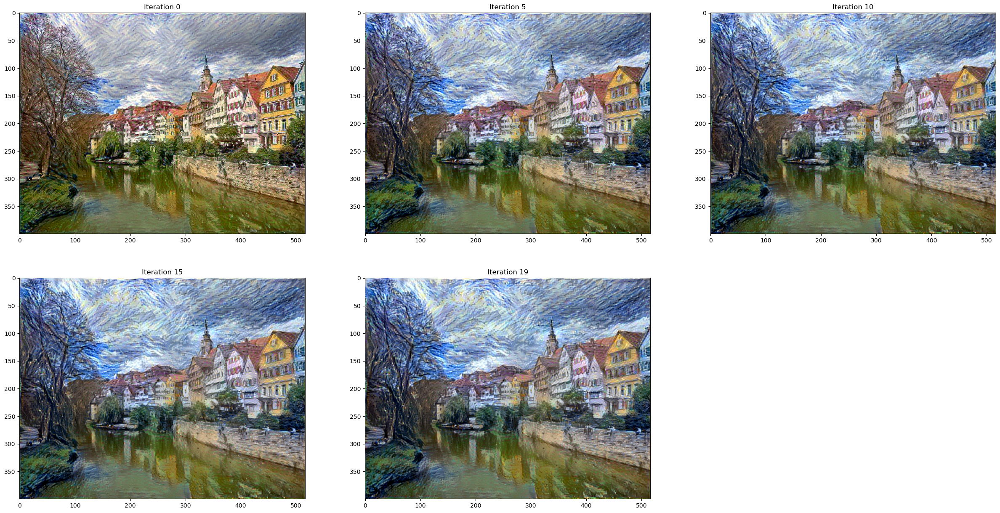

In [95]:
total_variation_weight = 0.1
style_weight = 10
content_weight = 10

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

images = []
iterations_to_show = [0,5,10,15,19]
for n_iter in iterations_to_show:
    images.append(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % n_iter))))

plt.figure(figsize=(30,15))
columns = 3
for i, image in enumerate(images):
    plt.subplot(len(images) // columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.title("Iteration %d"%iterations_to_show[i])

En el siguiente caso, sólo se aumentó el total_variation_weight respecto a la imagen generada con los pesos iniciales. Se peude observar que al aumento de este filtrado de ruido reduce la nitidez de la imagen, provocando que los contornos se vean menos marcados y dando un aspecto de difuminado.

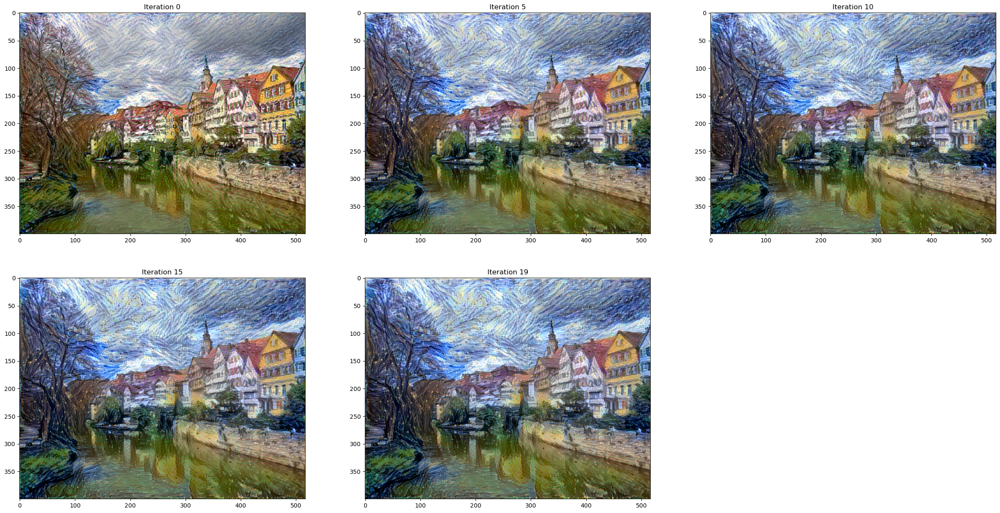

In [94]:
total_variation_weight = 1
style_weight = 10
content_weight = 1

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

images = []
iterations_to_show = [0,5,10,15,19]
for n_iter in iterations_to_show:
    images.append(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % n_iter))))

plt.figure(figsize=(30,15))
columns = 3
for i, image in enumerate(images):
    plt.subplot(len(images) // columns + 1, columns, i + 1)
    plt.imshow(image)
    plt.title("Iteration %d"%iterations_to_show[i])

# 9) Cambiar las imágenes de contenido y estilo por unas elegidas por usted. Adjuntar el resultado.

Respuesta:

En un primer caso se toman las siguientes imagenes:

Text(0.5, 1.0, 'Imagen de estilo')

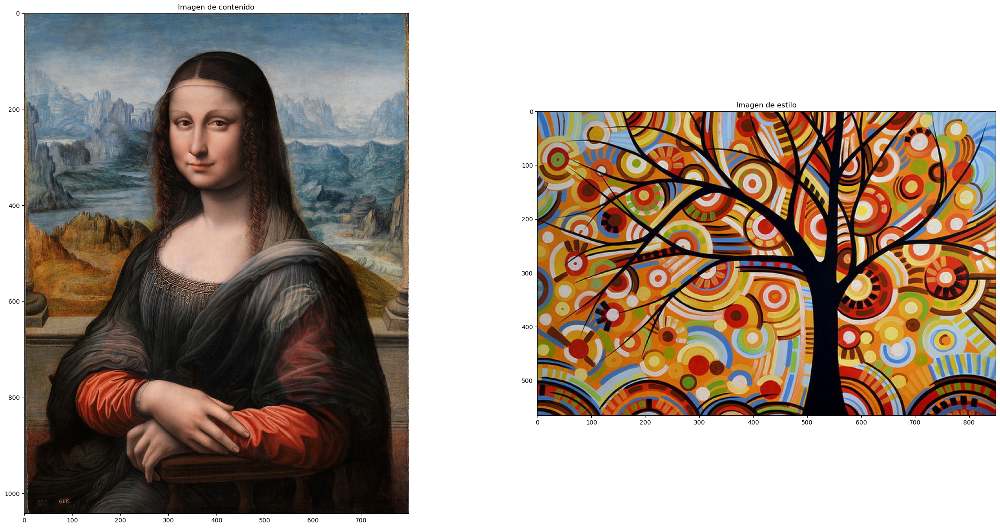

In [260]:
base_image_path = Path("content/800px-Gioconda.jpg")
style_reference_image_path = Path("content/paisajes-coloridos-arte-moderno.jpg")
result_prefix = Path("content/output2")

plt.figure(figsize=(30,15))
plt.subplot(1, 2, 1)
plt.imshow(mpimg.imread(base_image_path))
plt.title("Imagen de contenido")
plt.subplot(1, 2, 2)
plt.imshow(mpimg.imread(style_reference_image_path))
plt.title("Imagen de estilo")

Corriendo con los siguientes hiperparámetros:

Text(0.5, 1.0, 'Imagen de contenido')

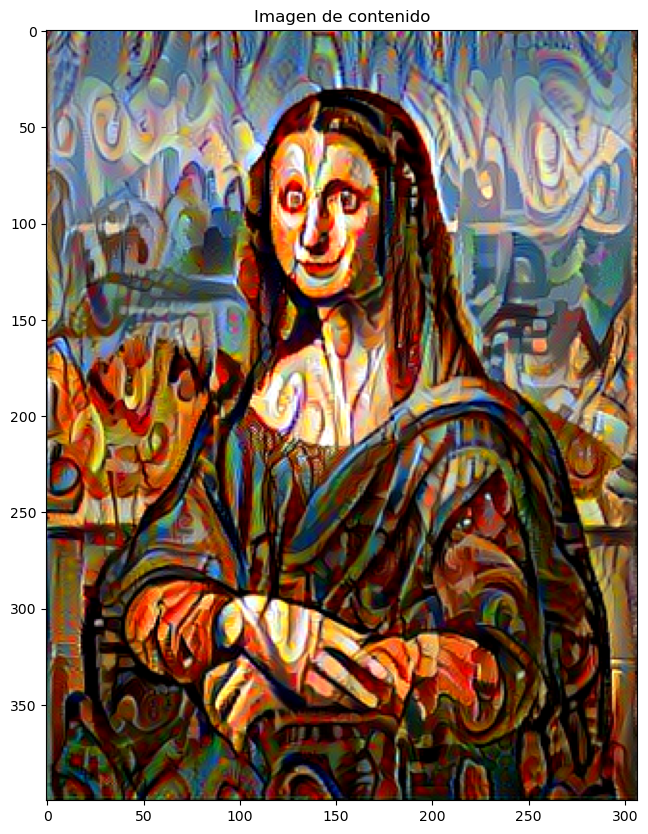

In [263]:
total_variation_weight = 0.1
style_weight = 10
content_weight = 1

iterations = 20

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

plt.figure(figsize=(10,10))
plt.imshow(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % (iterations-1)))))
plt.title("Imagen de contenido")

En un segundo caso se toman las siguientes imagenes:

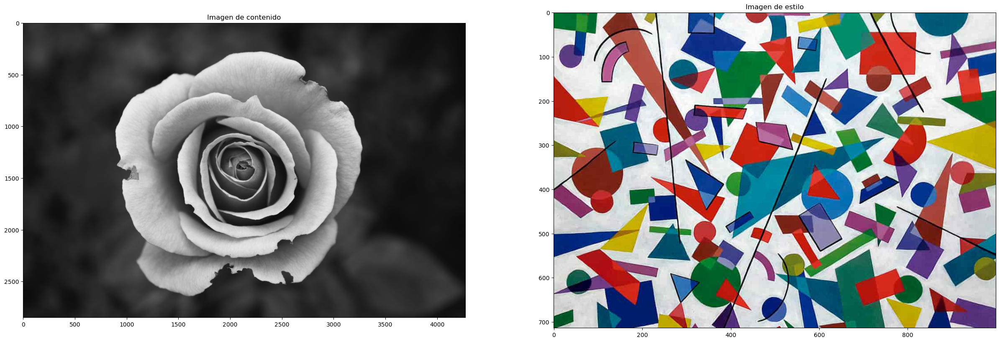

In [255]:
base_image_path = Path("content/pexels-jack-hawley-57905.jpg")
style_reference_image_path = Path("content/Formas-Geométricas.jpg")
result_prefix = Path("content/output3")

plt.figure(figsize=(30,15))
plt.subplot(1, 2, 1)
plt.imshow(mpimg.imread(base_image_path))
plt.title("Imagen de contenido")
plt.subplot(1, 2, 2)
plt.imshow(mpimg.imread(style_reference_image_path))
plt.title("Imagen de estilo")
plt.show()

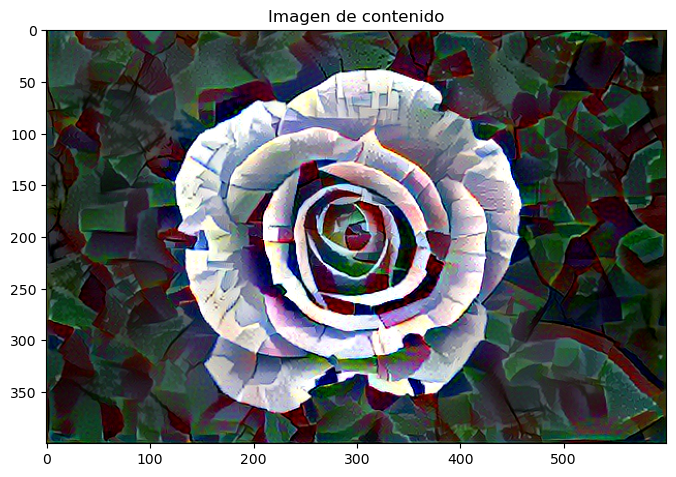

In [259]:
total_variation_weight = 0.1
style_weight = 50
content_weight = 1

iterations = 10

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

plt.figure(figsize=(8,8))
plt.imshow(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % (iterations-1)))))
plt.title("Imagen de contenido")
plt.show()

En un tercer ejemplo se toman las siguientes imagenes:

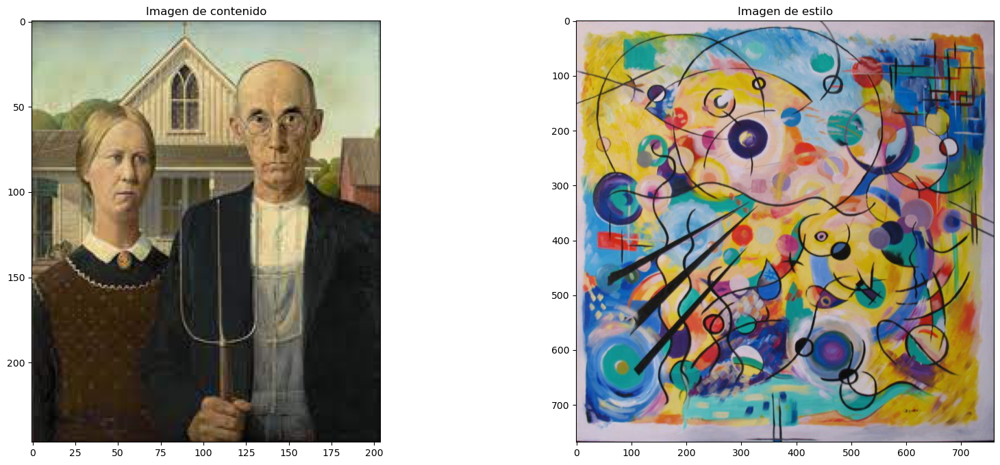

In [268]:
base_image_path = Path("content/grant_wood.jpg")
style_reference_image_path = Path("content/entender-el-arte-contemporáneo.jpg")
result_prefix = Path("content/output4")

plt.figure(figsize=(20,8))
plt.subplot(1, 2, 1)
plt.imshow(mpimg.imread(base_image_path))
plt.title("Imagen de contenido")
plt.subplot(1, 2, 2)
plt.imshow(mpimg.imread(style_reference_image_path))
plt.title("Imagen de estilo")
plt.show()

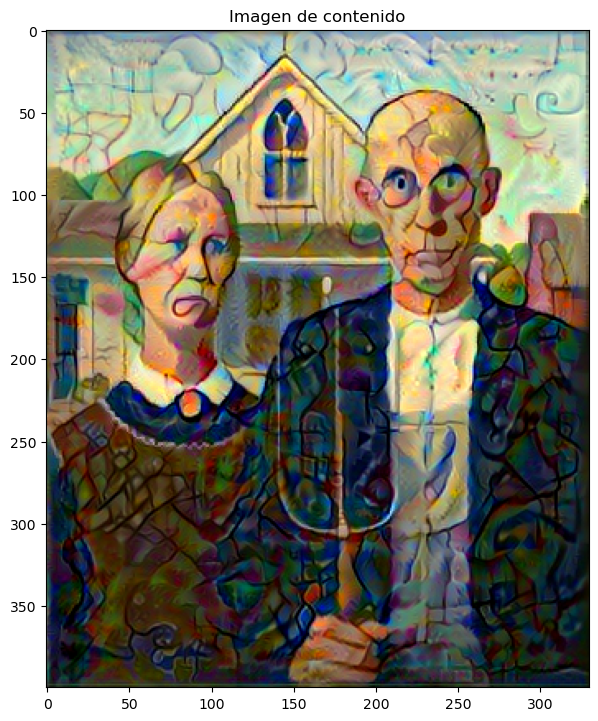

In [290]:
total_variation_weight = 0.1
style_weight = 100
content_weight = 1

iterations = 6

out_folder =os.path.join(str(result_prefix), 'output_stylew_{}_contw_{}_totvarw_{}'.format(style_weight,content_weight,total_variation_weight).replace('.','p'))

plt.figure(figsize=(7,10))
plt.imshow(mpimg.imread(os.path.join(out_folder, ('output_at_iteration_%d.png' % (iterations-1)))))
plt.title("Imagen de contenido")
plt.show()